In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_absolute_error, mean_squared_error
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import kpss
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
from tbats import TBATS
from sklearn.metrics import r2_score,mean_absolute_percentage_error
from prophet import Prophet
import pandas as pd
import numpy as np
from prophet import Prophet
import warnings
warnings.filterwarnings('ignore')




### Importation des données

In [2]:
df = pd.read_csv('orders.csv')
df

,Customer ID,Customer Status,Date Order was placed,Delivery Date,Order ID,Product ID,Quantity Ordered,Total Retail Price for This Order,Cost Price Per Unit
0,579,Silver,01-Jan-17,07-Jan-17,123002578,220101400106,2,92.6,20.70
1,7574,SILVER,01-Jan-17,05-Jan-17,123004074,210201000009,1,21.7,9.95
2,28861,Gold,01-Jan-17,04-Jan-17,123000871,230100500068,1,1.7,0.80
3,43796,Gold,01-Jan-17,06-Jan-17,123002851,220100100633,1,47.9,24.05
4,54673,Gold,01-Jan-17,04-Jan-17,123003607,220200200043,1,36.9,18.30
...,...,...,...,...,...,...,...,...,...
185008,92467,SILVER,31-Dec-21,31-Dec-21,124433239,240100200001,4,64.0,6.35
185009,92866,Silver,31-Dec-21,31-Dec-21,124436561,230100500058,1,16.7,7.25
185010,92894,Silver,31-Dec-21,31-Dec-21,124434316,220200100035,5,313.0,31.40
185011,93239,Gold,31-Dec-21,02-Jan-22,124436170,220200200047,2,271.6,68.00


<Axes: xlabel='Product Category'>

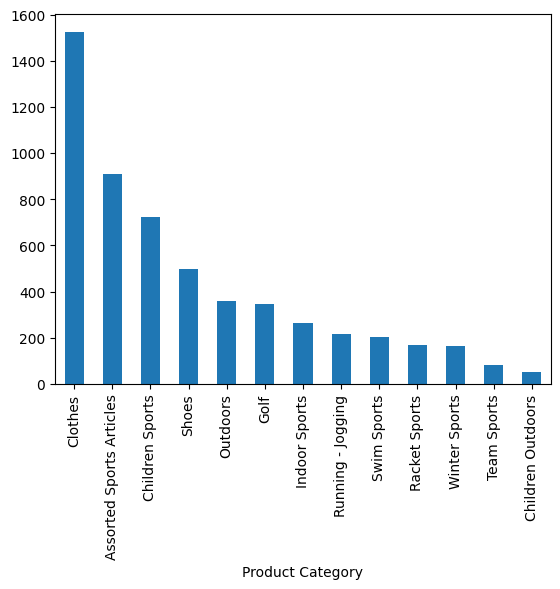

In [3]:
products = pd.read_csv('product-supplier.csv')
products['Product Category'].value_counts().plot(kind='bar')

In [4]:
df_merged = df.merge(products, on='Product ID', how='left')

In [5]:
df_merged.head()

,Customer ID,Customer Status,Date Order was placed,Delivery Date,Order ID,Product ID,Quantity Ordered,Total Retail Price for This Order,Cost Price Per Unit,Product Line,Product Category,Product Group,Product Name,Supplier Country,Supplier Name,Supplier ID
0,579,Silver,01-Jan-17,07-Jan-17,123002578,220101400106,2,92.6,20.70,Clothes & Shoes,Clothes,Tracker Clothes,Casual V-Neck Men's Sweatshirt,US,3Top Sports,2963
1,7574,SILVER,01-Jan-17,05-Jan-17,123004074,210201000009,1,21.7,9.95,Children,Children Sports,Tracker Kid's Clothes,Children's Tee,US,3Top Sports,2963
2,28861,Gold,01-Jan-17,04-Jan-17,123000871,230100500068,1,1.7,0.80,Outdoors,Outdoors,Outdoor Gear,Plate Picnic Deep,GB,Prime Sports Ltd,316
3,43796,Gold,01-Jan-17,06-Jan-17,123002851,220100100633,1,47.9,24.05,Clothes & Shoes,Clothes,Eclipse Clothing,Woman's Woven Pants L,US,Eclipse Inc,1303
4,54673,Gold,01-Jan-17,04-Jan-17,123003607,220200200043,1,36.9,18.30,Clothes & Shoes,Shoes,Shoes,Soft Gel Court Men's Indoor Shoes,US,Pro Sportswear Inc,1747


### Nettoyage des données

In [6]:
df.shape

(185013, 9)

In [7]:
print(df.isnull().sum())

Customer ID                          0
Customer Status                      0
Date Order was placed                0
Delivery Date                        0
Order ID                             0
Product ID                           0
Quantity Ordered                     0
Total Retail Price for This Order    0
Cost Price Per Unit                  0
dtype: int64


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185013 entries, 0 to 185012
Data columns (total 9 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Customer ID                        185013 non-null  int64  
 1   Customer Status                    185013 non-null  object 
 2   Date Order was placed              185013 non-null  object 
 3   Delivery Date                      185013 non-null  object 
 4   Order ID                           185013 non-null  int64  
 5   Product ID                         185013 non-null  int64  
 6   Quantity Ordered                   185013 non-null  int64  
 7   Total Retail Price for This Order  185013 non-null  float64
 8   Cost Price Per Unit                185013 non-null  float64
dtypes: float64(2), int64(4), object(3)
memory usage: 12.7+ MB


In [9]:
df_merged['Date Order was placed'] = pd.to_datetime(
    df['Date Order was placed'],
    format='%d-%b-%y',       
    errors='coerce'           
)

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185013 entries, 0 to 185012
Data columns (total 9 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Customer ID                        185013 non-null  int64  
 1   Customer Status                    185013 non-null  object 
 2   Date Order was placed              185013 non-null  object 
 3   Delivery Date                      185013 non-null  object 
 4   Order ID                           185013 non-null  int64  
 5   Product ID                         185013 non-null  int64  
 6   Quantity Ordered                   185013 non-null  int64  
 7   Total Retail Price for This Order  185013 non-null  float64
 8   Cost Price Per Unit                185013 non-null  float64
dtypes: float64(2), int64(4), object(3)
memory usage: 12.7+ MB


In [11]:
df.head()

,Customer ID,Customer Status,Date Order was placed,Delivery Date,Order ID,Product ID,Quantity Ordered,Total Retail Price for This Order,Cost Price Per Unit
0,579,Silver,01-Jan-17,07-Jan-17,123002578,220101400106,2,92.6,20.70
1,7574,SILVER,01-Jan-17,05-Jan-17,123004074,210201000009,1,21.7,9.95
2,28861,Gold,01-Jan-17,04-Jan-17,123000871,230100500068,1,1.7,0.80
3,43796,Gold,01-Jan-17,06-Jan-17,123002851,220100100633,1,47.9,24.05
4,54673,Gold,01-Jan-17,04-Jan-17,123003607,220200200043,1,36.9,18.30


In [12]:
df[df['Date Order was placed'].isna()].shape[0]

0

In [13]:
df.duplicated().sum()

0

In [14]:
df[df['Quantity Ordered'] < 0].shape[0]

0

### Analyse exploratoire

**Analyse Temporelle**

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185013 entries, 0 to 185012
Data columns (total 9 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Customer ID                        185013 non-null  int64  
 1   Customer Status                    185013 non-null  object 
 2   Date Order was placed              185013 non-null  object 
 3   Delivery Date                      185013 non-null  object 
 4   Order ID                           185013 non-null  int64  
 5   Product ID                         185013 non-null  int64  
 6   Quantity Ordered                   185013 non-null  int64  
 7   Total Retail Price for This Order  185013 non-null  float64
 8   Cost Price Per Unit                185013 non-null  float64
dtypes: float64(2), int64(4), object(3)
memory usage: 12.7+ MB


In [16]:
df["Date Order was placed"]=pd.to_datetime(df["Date Order was placed"],errors='coerce')

/var/folders/16/zyyw4ff963g9rk8kn26vv6280000gn/T/ipykernel_29743/1885400831.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df["Date Order was placed"]=pd.to_datetime(df["Date Order was placed"],errors='coerce')


/var/folders/16/zyyw4ff963g9rk8kn26vv6280000gn/T/ipykernel_29743/4059692406.py:3: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = daily_sales.resample('M').sum()


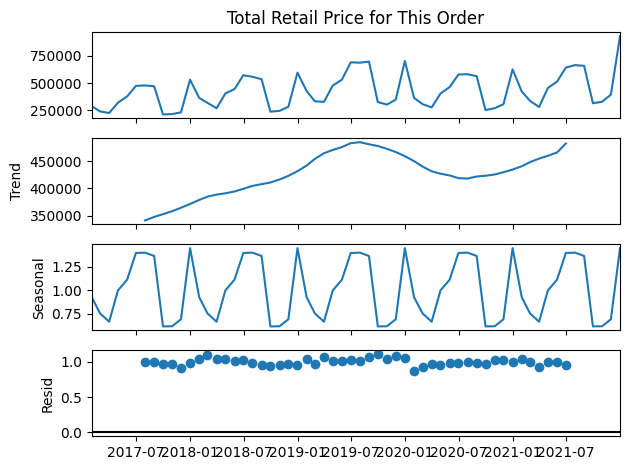

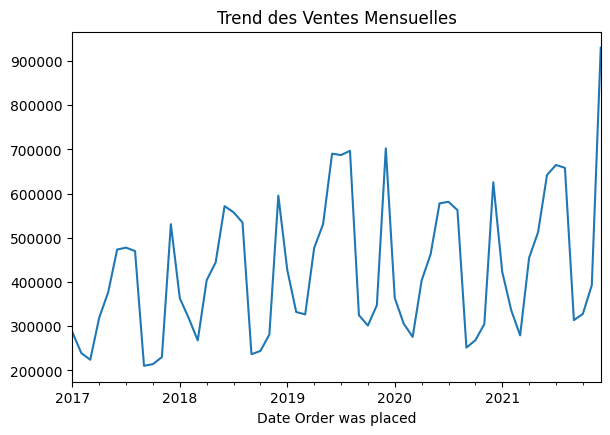

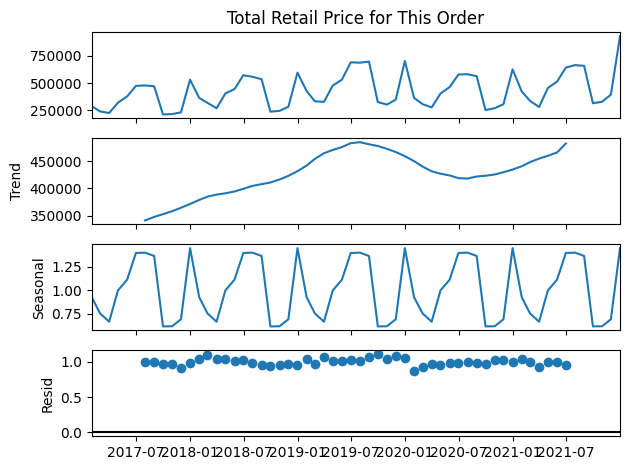

In [17]:
# Agrégation par période
daily_sales = df.groupby('Date Order was placed')['Total Retail Price for This Order'].sum()
monthly_sales = daily_sales.resample('M').sum()

# Visualisations
plt.figure(figsize=(15, 10))

# Trend des ventes
plt.subplot(2, 2, 1)
monthly_sales.plot(title='Trend des Ventes Mensuelles')

# Seasonal decomposition
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(monthly_sales, model='multiplicative', period=12)
decomposition.plot()

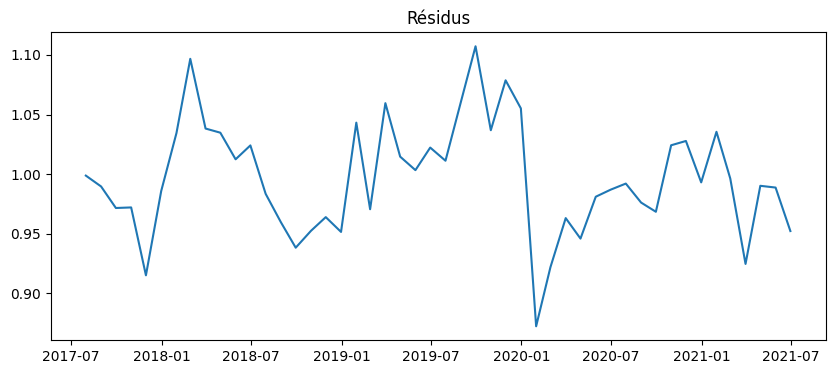

In [18]:
plt.figure(figsize=(10,4))
plt.plot(abs(decomposition.resid))
plt.title("Résidus")
plt.show()

In [19]:
print("Mean:", decomposition.resid.mean())
print("Std:", decomposition.resid.std())

Mean: 0.9964186222213923
Std: 0.04759401294464758


La saisonnalité augmente quand la tendance augmente. Pour cette raison on a opté de choisir le model multiplicatif

##### **Interprétation** :

La moyenne ≈ 1 → normal dans un modèle multiplicatif (résidu = ratio)

Très faible standard deviation (≈ 0.05)

- les résidus sont très proches de 1.

- faible erreur, très bonne stabilité.

➝ modèle très cohérent.

In [20]:
df['Customer Status'] = df['Customer Status'].replace("GOLD", "Gold")
df['Customer Status'] = df['Customer Status'].replace("PLATINUM", "Platinum")
df['Customer Status'] = df['Customer Status'].replace("SILVER", "Silver")

In [21]:
df['Customer Status'].value_counts()

Customer Status
Silver      92541
Gold        88278
Platinum     4194
Name: count, dtype: int64

<Axes: title={'center': 'Quantité Totale Commandée par Statut de Client'}, xlabel='Customer Status'>

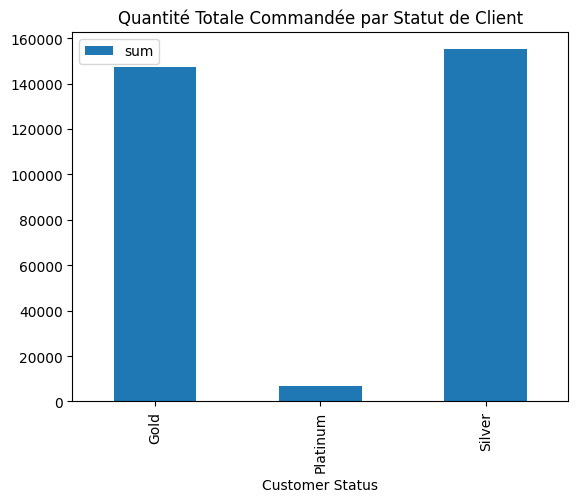

In [22]:
# Comportement des clients par statut
customer_analysis = df.groupby('Customer Status').agg({
    'Total Retail Price for This Order': ['sum', 'mean', 'count'],
    'Quantity Ordered': 'sum'
})

# Customer Lifetime Value
clv = df.groupby('Customer ID').agg({
    'Total Retail Price for This Order': 'sum',
    'Order ID': 'count'
}).rename(columns={'Total Retail Price for This Order': 'Total_Revenue', 'Order ID': 'Purchase_Count'})

#Visualisation 
customer_analysis['Quantity Ordered'].plot(kind='bar', title='Quantité Totale Commandée par Statut de Client')

<Axes: title={'center': 'Revenu Total par Statut de Client'}, xlabel='Customer Status'>

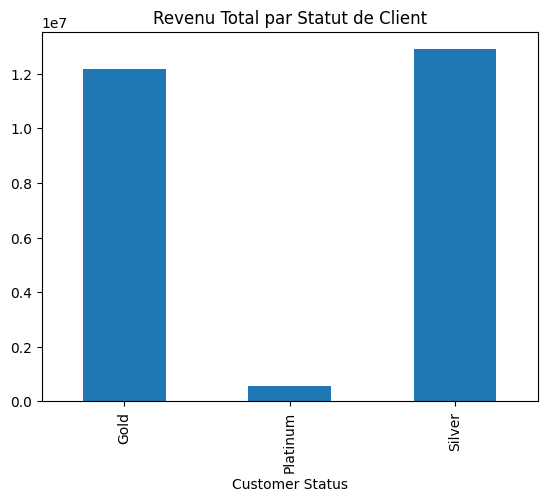

In [23]:
customer_analysis['Total Retail Price for This Order']['sum'].plot(kind='bar', title='Revenu Total par Statut de Client')

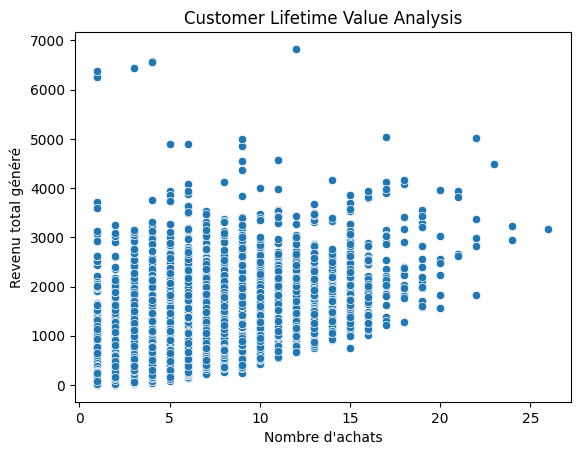

In [24]:
sns.scatterplot(data=clv, x='Purchase_Count', y='Total_Revenue')
plt.title('Customer Lifetime Value Analysis')
plt.xlabel('Nombre d\'achats')
plt.ylabel('Revenu total généré')
plt.show()

#### Analyse des Produits

In [25]:
df_merged.head()

,Customer ID,Customer Status,Date Order was placed,Delivery Date,Order ID,Product ID,Quantity Ordered,Total Retail Price for This Order,Cost Price Per Unit,Product Line,Product Category,Product Group,Product Name,Supplier Country,Supplier Name,Supplier ID
0,579,Silver,2017-01-01,07-Jan-17,123002578,220101400106,2,92.6,20.70,Clothes & Shoes,Clothes,Tracker Clothes,Casual V-Neck Men's Sweatshirt,US,3Top Sports,2963
1,7574,SILVER,2017-01-01,05-Jan-17,123004074,210201000009,1,21.7,9.95,Children,Children Sports,Tracker Kid's Clothes,Children's Tee,US,3Top Sports,2963
2,28861,Gold,2017-01-01,04-Jan-17,123000871,230100500068,1,1.7,0.80,Outdoors,Outdoors,Outdoor Gear,Plate Picnic Deep,GB,Prime Sports Ltd,316
3,43796,Gold,2017-01-01,06-Jan-17,123002851,220100100633,1,47.9,24.05,Clothes & Shoes,Clothes,Eclipse Clothing,Woman's Woven Pants L,US,Eclipse Inc,1303
4,54673,Gold,2017-01-01,04-Jan-17,123003607,220200200043,1,36.9,18.30,Clothes & Shoes,Shoes,Shoes,Soft Gel Court Men's Indoor Shoes,US,Pro Sportswear Inc,1747


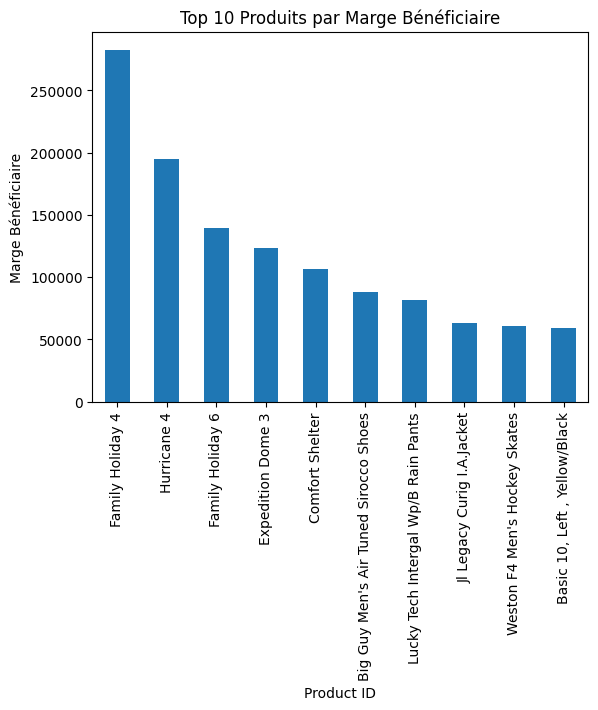

In [26]:
# Produits les plus rentables
product_performance = df_merged.groupby('Product Name').agg({
    'Quantity Ordered': 'sum',
    'Total Retail Price for This Order': 'sum',
    'Cost Price Per Unit': 'mean'
})

# Marge par produit
product_performance['Profit_Margin'] = (
    product_performance['Total Retail Price for This Order'] - 
    (product_performance['Quantity Ordered'] * product_performance['Cost Price Per Unit'])
)

#Visualisation
top_products = product_performance.sort_values(by='Profit_Margin', ascending=False).head(10)
top_products['Profit_Margin'].plot(kind='bar', title='Top 10 Produits par Marge Bénéficiaire')
plt.xlabel('Product ID')
plt.ylabel('Marge Bénéficiaire')
plt.show()

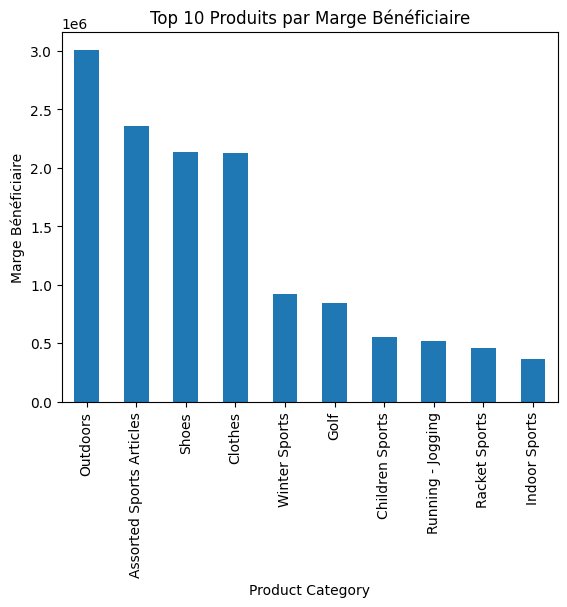

In [27]:
# Produits les plus rentables par categorie
product_performance_par_categorie = df_merged.groupby('Product Category').agg({
    'Quantity Ordered': 'sum',
    'Total Retail Price for This Order': 'sum',
    'Cost Price Per Unit': 'mean'
})

# Marge par produit
product_performance_par_categorie['Profit_Margin'] = (
    product_performance_par_categorie['Total Retail Price for This Order'] - 
    (product_performance_par_categorie['Quantity Ordered'] * product_performance_par_categorie['Cost Price Per Unit'])
)

#Visualisation
top_products = product_performance_par_categorie.sort_values(by='Profit_Margin', ascending=False).head(10)
top_products['Profit_Margin'].plot(kind='bar', title='Top 10 Produits par Marge Bénéficiaire')
plt.xlabel('Product Category')
plt.ylabel('Marge Bénéficiaire')
plt.show()

###  Feature engineering pour Time Series

**Création de features temporelles**

In [28]:
# Features de date
df_merged['year'] = df_merged['Date Order was placed'].dt.year
df_merged['month'] = df_merged['Date Order was placed'].dt.month
df_merged['quarter'] = df_merged['Date Order was placed'].dt.quarter
df_merged['day_of_week'] = df_merged['Date Order was placed'].dt.dayofweek
df_merged['is_weekend'] = df_merged['day_of_week'].isin([5, 6]).astype(int)

In [29]:
df_merged.head()

,Customer ID,Customer Status,Date Order was placed,Delivery Date,Order ID,Product ID,Quantity Ordered,Total Retail Price for This Order,Cost Price Per Unit,Product Line,...,Product Group,Product Name,Supplier Country,Supplier Name,Supplier ID,year,month,quarter,day_of_week,is_weekend
0,579,Silver,2017-01-01,07-Jan-17,123002578,220101400106,2,92.6,20.70,Clothes & Shoes,...,Tracker Clothes,Casual V-Neck Men's Sweatshirt,US,3Top Sports,2963,2017,1,1,6,1
1,7574,SILVER,2017-01-01,05-Jan-17,123004074,210201000009,1,21.7,9.95,Children,...,Tracker Kid's Clothes,Children's Tee,US,3Top Sports,2963,2017,1,1,6,1
2,28861,Gold,2017-01-01,04-Jan-17,123000871,230100500068,1,1.7,0.80,Outdoors,...,Outdoor Gear,Plate Picnic Deep,GB,Prime Sports Ltd,316,2017,1,1,6,1
3,43796,Gold,2017-01-01,06-Jan-17,123002851,220100100633,1,47.9,24.05,Clothes & Shoes,...,Eclipse Clothing,Woman's Woven Pants L,US,Eclipse Inc,1303,2017,1,1,6,1
4,54673,Gold,2017-01-01,04-Jan-17,123003607,220200200043,1,36.9,18.30,Clothes & Shoes,...,Shoes,Soft Gel Court Men's Indoor Shoes,US,Pro Sportswear Inc,1747,2017,1,1,6,1


In [30]:
# Lag features
def create_time_features(series, lags=[1, 7, 30, 90]):
    for lag in lags:
        series[f'lag_{lag}'] = series.shift(lag)
    return series

# Rolling statistics
df_merged['rolling_mean_7'] = df_merged['Total Retail Price for This Order'].rolling(window=7).mean()
df_merged['rolling_std_7'] = df_merged['Total Retail Price for This Order'].rolling(window=7).std()

In [31]:
df_merged

,Customer ID,Customer Status,Date Order was placed,Delivery Date,Order ID,Product ID,Quantity Ordered,Total Retail Price for This Order,Cost Price Per Unit,Product Line,...,Supplier Country,Supplier Name,Supplier ID,year,month,quarter,day_of_week,is_weekend,rolling_mean_7,rolling_std_7
0,579,Silver,2017-01-01,07-Jan-17,123002578,220101400106,2,92.6,20.70,Clothes & Shoes,...,US,3Top Sports,2963,2017,1,1,6,1,NaN,NaN
1,7574,SILVER,2017-01-01,05-Jan-17,123004074,210201000009,1,21.7,9.95,Children,...,US,3Top Sports,2963,2017,1,1,6,1,NaN,NaN
2,28861,Gold,2017-01-01,04-Jan-17,123000871,230100500068,1,1.7,0.80,Outdoors,...,GB,Prime Sports Ltd,316,2017,1,1,6,1,NaN,NaN
3,43796,Gold,2017-01-01,06-Jan-17,123002851,220100100633,1,47.9,24.05,Clothes & Shoes,...,US,Eclipse Inc,1303,2017,1,1,6,1,NaN,NaN
4,54673,Gold,2017-01-01,04-Jan-17,123003607,220200200043,1,36.9,18.30,Clothes & Shoes,...,US,Pro Sportswear Inc,1747,2017,1,1,6,1,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
185008,92467,SILVER,2021-12-31,31-Dec-21,124433239,240100200001,4,64.0,6.35,Sports,...,GB,Royal Darts Ltd,4514,2021,12,4,4,0,110.491429,109.263261
185009,92866,Silver,2021-12-31,31-Dec-21,124436561,230100500058,1,16.7,7.25,Outdoors,...,GB,Prime Sports Ltd,316,2021,12,4,4,0,85.248571,107.310569
185010,92894,Silver,2021-12-31,31-Dec-21,124434316,220200100035,5,313.0,31.40,Clothes & Shoes,...,US,Eclipse Inc,1303,2021,12,4,4,0,84.877143,106.380854
185011,93239,Gold,2021-12-31,02-Jan-22,124436170,220200200047,2,271.6,68.00,Clothes & Shoes,...,US,Pro Sportswear Inc,1747,2021,12,4,4,0,120.691429,122.266802


### Modélisation Time Series

**Préparation des Données pour Modélisation**

In [32]:
# Séries temporelles pour modélisation
ts_data = df_merged.set_index('Date Order was placed')['Total Retail Price for This Order'].resample('D').sum()

ts_data.head()

Date Order was placed
2017-01-01      225.50
2017-01-02    10476.30
2017-01-03     8683.20
2017-01-04     3434.19
2017-01-05     9129.80
Freq: D, Name: Total Retail Price for This Order, dtype: float64

In [33]:
# Train-test split (80-20)
train_size = int(len(ts_data) * 0.8)
train, test = ts_data[:train_size], ts_data[train_size:]

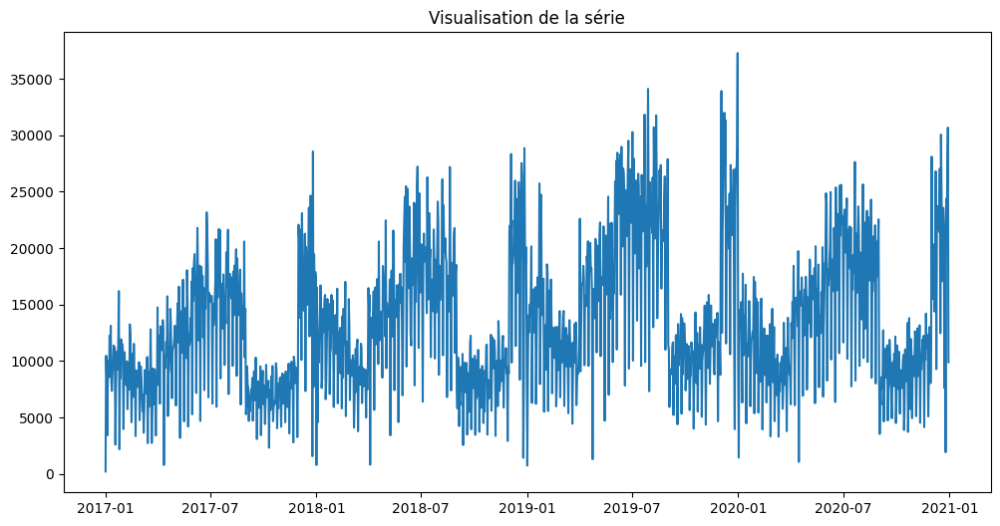

In [34]:
plt.figure(figsize=(12, 6))
plt.plot(train)
plt.title('Visualisation de la série')
plt.show()

**Implémentation des Modèles**

Analyse ACF et PACF pour la Sélection des Paramètres

In [35]:
# Test de stationnarité (ADF test)
#Par défaut, la fonction adfuller() de statsmodels utilise un modèle AVEC constante mais SANS tendance.
adf_result = adfuller(train)
print("Test de Stationnarité (ADF) :")
#ADF Statistic = γ / erreur standard(γ)
print(f"ADF Statistic: {adf_result[0]:.6f}")
print(f"P-value: {adf_result[1]:.6f}")
if adf_result[1] < 0.05:
    print("Série stationnaire (rejeter H0)")
else:
    print("Série non-stationnaire (accepter H0)")

Test de Stationnarité (ADF) :
ADF Statistic: -4.240610
P-value: 0.000562
Série stationnaire (rejeter H0)


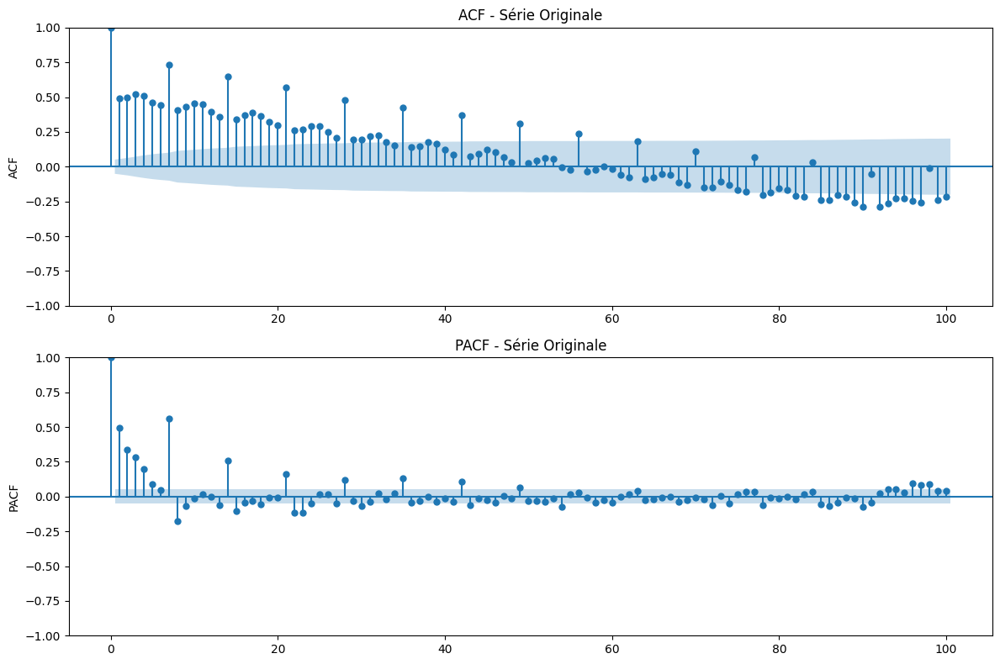

In [36]:
# Visualisation ACF et PACF pour la série originale
fig, axes = plt.subplots(2, 1, figsize=(12, 8))

# ACF
plot_acf(train.dropna(), lags=100, ax=axes[0])
axes[0].set_title('ACF - Série Originale')
axes[0].set_ylabel('ACF')

# PACF
plot_pacf(train.dropna(), lags=100, ax=axes[1], method='ywmle')
axes[1].set_title('PACF - Série Originale')
axes[1].set_ylabel('PACF')

plt.tight_layout()
plt.show()

In [37]:
kpss_result = kpss(train, regression='c')
print("Test KPSS (H0: série stationnaire)")
print(f"KPSS Statistic: {kpss_result[0]:.6f}")
print(f"P-value: {kpss_result[1]:.6f}")
if kpss_result[1] > 0.05:
    print("KPSS dit: Stationnaire")
else:
    print("KPSS dit: Non-stationnaire")

Test KPSS (H0: série stationnaire)
KPSS Statistic: 0.697729
P-value: 0.013752
KPSS dit: Non-stationnaire


### ARIMA

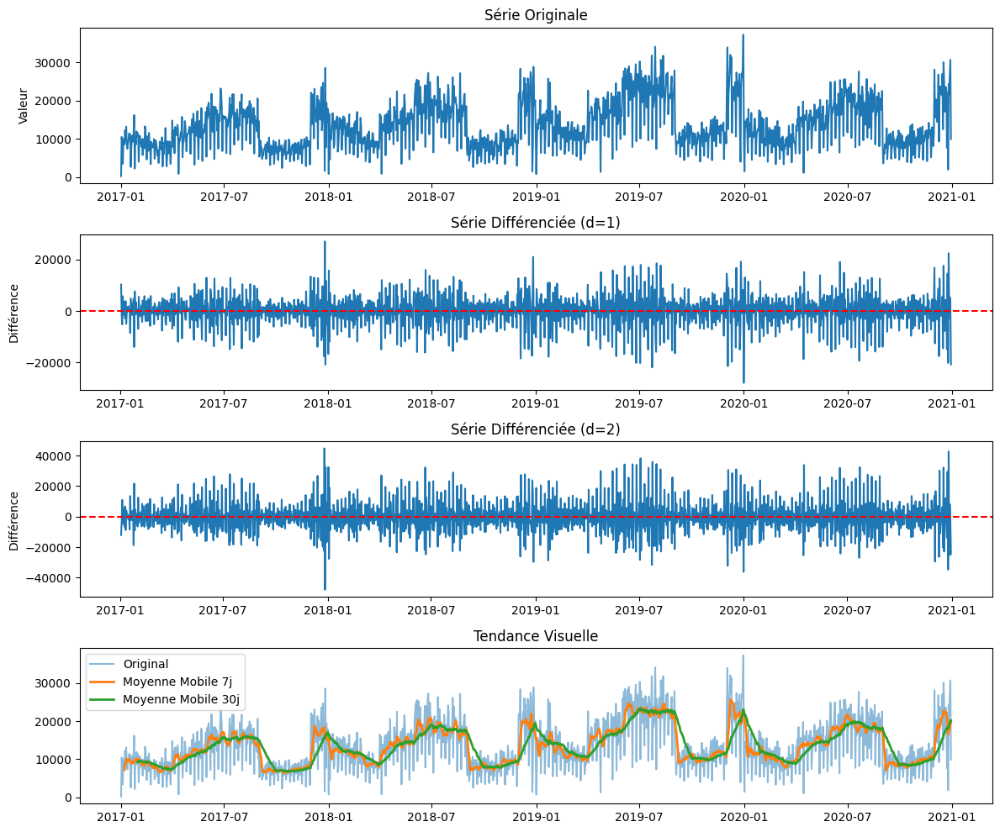


ADF sur série différenciée
P-value: 0.000000


In [38]:
fig, axes = plt.subplots(4, 1, figsize=(12, 10))

# 1. Série originale
axes[0].plot(train)
axes[0].set_title('Série Originale')
axes[0].set_ylabel('Valeur')

# 2. Série différenciée (d=1)
diff_series = train.diff().dropna()
axes[1].plot(diff_series)
axes[1].set_title('Série Différenciée (d=1)')
axes[1].set_ylabel('Différence')
axes[1].axhline(y=0, color='r', linestyle='--')

# 2. Série différenciée (d=2)
diff_series_2 = train.diff().diff().dropna()
axes[2].plot(diff_series_2)
axes[2].set_title('Série Différenciée (d=2)')
axes[2].set_ylabel('Différence')
axes[2].axhline(y=0, color='r', linestyle='--')

# 3. Comparaison des moyennes mobiles
axes[3].plot(train, label='Original', alpha=0.5)
axes[3].plot(train.rolling(window=7).mean(), label='Moyenne Mobile 7j', linewidth=2)
axes[3].plot(train.rolling(window=30).mean(), label='Moyenne Mobile 30j', linewidth=2)
axes[3].set_title('Tendance Visuelle')
axes[3].legend()

plt.tight_layout()
plt.show()

adf_diff = adfuller(diff_series)
print(f"\nADF sur série différenciée")
print(f"P-value: {adf_diff[1]:.6f}")

In [39]:
adf_result = adfuller(diff_series)
print("Test de Stationnarité (ADF) :")
#ADF Statistic = γ / erreur standard(γ)
print(f"ADF Statistic: {adf_result[0]:.6f}")
print(f"P-value: {adf_result[1]:.6f}")
if adf_result[1] < 0.05:
    print("Série stationnaire (rejeter H0)")
else:
    print("Série non-stationnaire (accepter H0)")

Test de Stationnarité (ADF) :
ADF Statistic: -7.963454
P-value: 0.000000
Série stationnaire (rejeter H0)


In [40]:
kpss_result = kpss(diff_series, regression='c')
print("Test KPSS (H0: série stationnaire)")
print(f"KPSS Statistic: {kpss_result[0]:.6f}")
print(f"P-value: {kpss_result[1]:.6f}")
if kpss_result[1] > 0.05:
    print("KPSS dit: Stationnaire")
else:
    print("KPSS dit: Non-stationnaire")

Test KPSS (H0: série stationnaire)
KPSS Statistic: 0.084167
P-value: 0.100000
KPSS dit: Stationnaire


/var/folders/16/zyyw4ff963g9rk8kn26vv6280000gn/T/ipykernel_29743/3739566465.py:1: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')


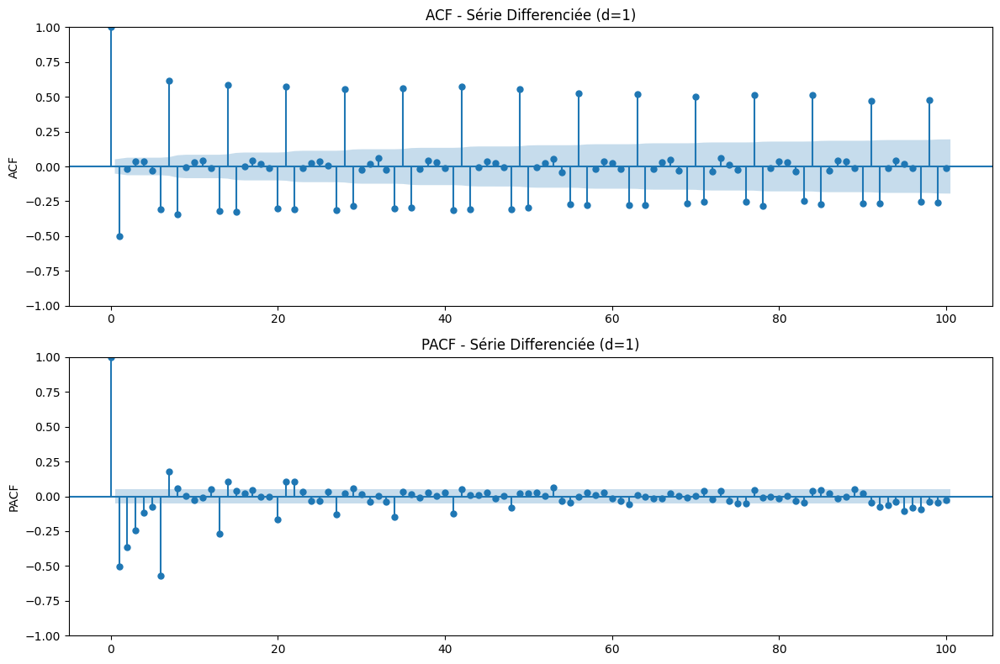

In [41]:
# Visualisation ACF et PACF pour la série originale
fig, axes = plt.subplots(2, 1, figsize=(12, 8))

# ACF
plot_acf(diff_series.dropna(), lags=100, ax=axes[0])
axes[0].set_title('ACF - Série Differenciée (d=1)')
axes[0].set_ylabel('ACF')

# PACF
plot_pacf(diff_series.dropna(), lags=100, ax=axes[1], method='ywmle')
axes[1].set_title('PACF - Série Differenciée (d=1)')
axes[1].set_ylabel('PACF')

plt.tight_layout()
plt.show()

**Sélection Automatique des Paramètres ARIMA/SARIMA**

1. DÉTERMINATION DE d et D
Série originale - p-value: 0.0006
Différence 1ère (d=1) - p-value: 0.0000
Différence saisonnière (D=1) - p-value: 0.0000
Différence 1ère + saisonnière - p-value: 0.0000
 d=1, D=1 (série stationnaire avec les deux différenciations)

2. DÉTERMINATION DE p, q, P, Q


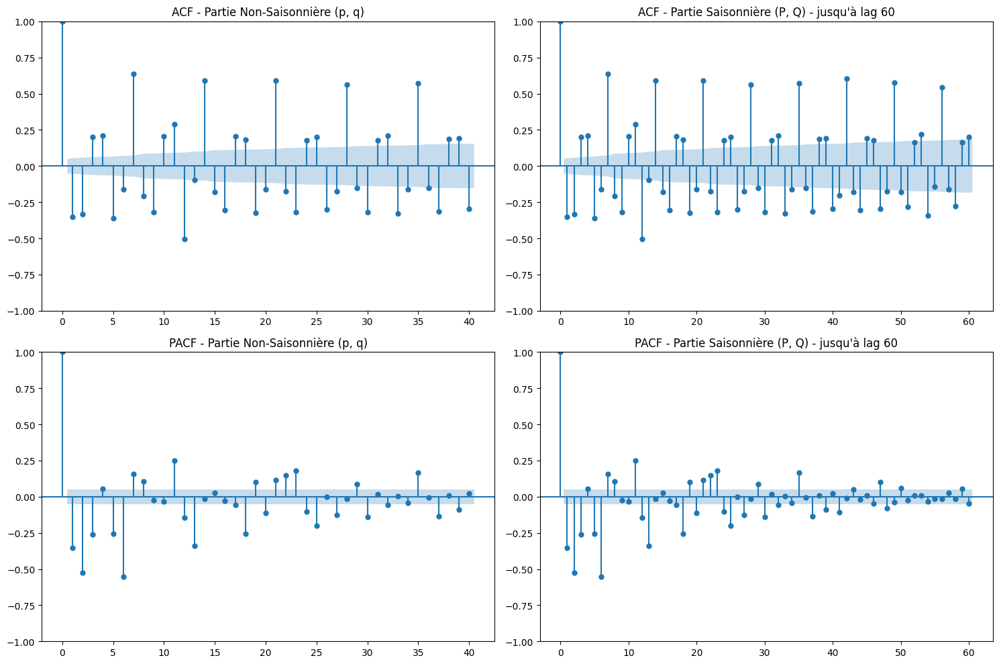

Paramètres:
   Non-saisonniers: p=5, d=1, q=5
   Saisonniers: P=1, D=1, Q=1, m=12


In [42]:
import warnings
warnings.filterwarnings('ignore')

m = 12  # 12 mois

def analyse_sarima_complete(serie, m):
    
    print("1. DÉTERMINATION DE d et D")
    
    adf_orig = adfuller(serie.dropna())
    print(f"Série originale - p-value: {adf_orig[1]:.4f}")
    
    # Différenciation simple (d=1)
    diff1 = serie.diff().dropna()
    adf_diff1 = adfuller(diff1)
    print(f"Différence 1ère (d=1) - p-value: {adf_diff1[1]:.4f}")
    
    # Différenciation saisonnière (D=1)
    diff_seasonal = serie.diff(m).dropna()
    adf_seasonal = adfuller(diff_seasonal)
    print(f"Différence saisonnière (D=1) - p-value: {adf_seasonal[1]:.4f}")
    
    # Différenciation simple + saisonnière (d=1, D=1)
    diff_both = serie.diff().diff(m).dropna()
    adf_both = adfuller(diff_both)
    print(f"Différence 1ère + saisonnière - p-value: {adf_both[1]:.4f}")
    
    # Détermination de d et D
    if adf_both[1] < 0.05:
        d, D = 1, 1
        print(f" d={d}, D={D} (série stationnaire avec les deux différenciations)")
    elif adf_diff1[1] < 0.05:
        d, D = 1, 0
        print(f" d={d}, D={D} (série stationnaire avec différence simple seulement)")
    else:
        d, D = 0, 0
        print(" Série non-stationnaire même après différenciation")
    
    
    print("\n2. DÉTERMINATION DE p, q, P, Q")
    
    if d == 1 and D == 1:
        serie_analyse = diff_both
    elif d == 1:
        serie_analyse = diff1
    else:
        serie_analyse = serie
    
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    
    plot_acf(serie_analyse, ax=axes[0,0], lags=min(40, len(serie_analyse)//4), title='ACF - Partie Non-Saisonnière (p, q)')
    plot_pacf(serie_analyse, ax=axes[1,0], lags=min(40, len(serie_analyse)//4), title='PACF - Partie Non-Saisonnière (p, q)')
    
    max_lags = min(5*m, len(serie_analyse)//3)
    plot_acf(serie_analyse, ax=axes[0,1], lags=max_lags, title=f'ACF - Partie Saisonnière (P, Q) - jusqu\'à lag {max_lags}')
    plot_pacf(serie_analyse, ax=axes[1,1], lags=max_lags, title=f'PACF - Partie Saisonnière (P, Q) - jusqu\'à lag {max_lags}')
    
    plt.tight_layout()
    plt.show()
    
    lags_acf = acf(serie_analyse, nlags=min(40, len(serie_analyse)//4))
    lags_pacf = pacf(serie_analyse, nlags=min(40, len(serie_analyse)//4))
    
    seuil = 1.96 / np.sqrt(len(serie_analyse))
    
    p = 0
    for i in range(1, min(6, len(lags_pacf))):
        if abs(lags_pacf[i]) > seuil:
            p = i
        else:
            break
    
    # Déterminer q (ACF - coupure après q lags)
    q = 0
    for i in range(1, min(6, len(lags_acf))):
        if abs(lags_acf[i]) > seuil:
            q = i
        else:
            break
    
    # Déterminer P et Q (pic au lag m dans ACF/PACF)
    lags_acf_long = acf(serie_analyse, nlags=min(5*m, len(serie_analyse)//3))
    lags_pacf_long = pacf(serie_analyse, nlags=min(5*m, len(serie_analyse)//3))
    
    P = 1 if m < len(lags_pacf_long) and abs(lags_pacf_long[m]) > seuil else 0
    Q = 1 if m < len(lags_acf_long) and abs(lags_acf_long[m]) > seuil else 0
    
    print(f"Paramètres:")
    print(f"   Non-saisonniers: p={p}, d={d}, q={q}")
    print(f"   Saisonniers: P={P}, D={D}, Q={Q}, m={m}")
    
    return (p, d, q), (P, D, Q, m)

order, seasonal_order = analyse_sarima_complete(train, m=12)

In [43]:
sarima_model = SARIMAX(train, order=order, seasonal_order=seasonal_order)
sarima_fit = sarima_model.fit()
sarima_forecast = sarima_fit.forecast(len(test))

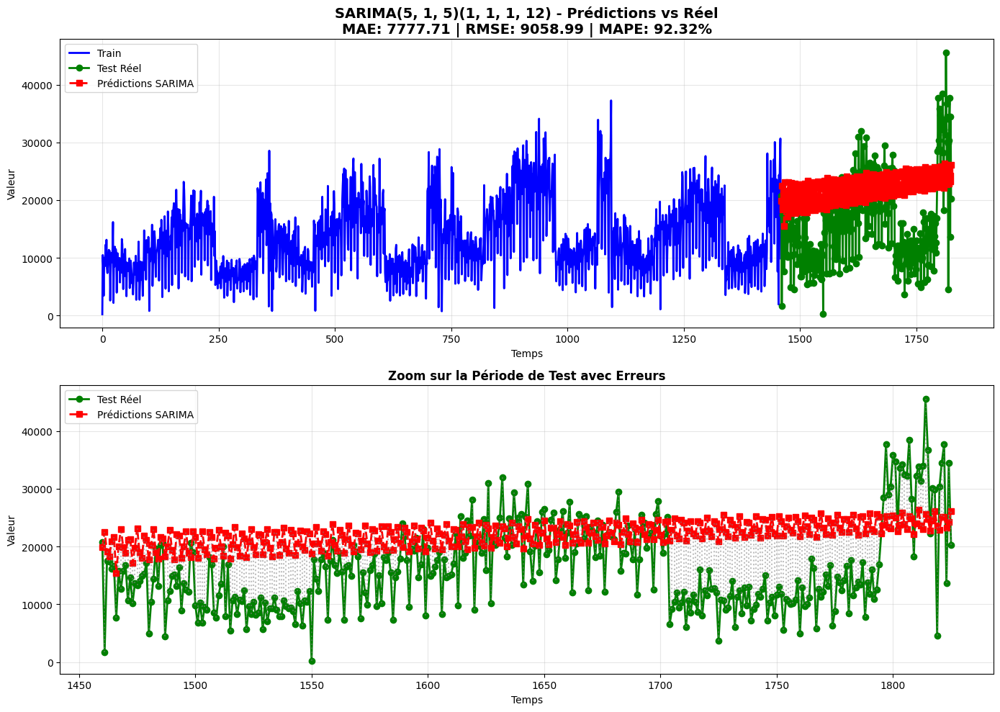

MÉTRIQUES DE PERFORMANCE:
MAE (Mean Absolute Error): 7777.7062
RMSE (Root Mean Square Error): 9058.9870
MAPE (Mean Absolute Percentage Error): 92.32%


In [44]:
def visualiser_predictions_sarima(train, test, sarima_forecast, model_order, seasonal_order):
    
    mae = mean_absolute_error(test, sarima_forecast)
    rmse = np.sqrt(mean_squared_error(test, sarima_forecast))
    mape = np.mean(np.abs((test - sarima_forecast) / test)) * 100
    
    # Création de la figure
    plt.figure(figsize=(14, 10))
    
    # Graphique 1: Série complète avec prédictions
    plt.subplot(2, 1, 1)
    
    # Indices pour l'affichage
    train_index = range(len(train))
    test_index = range(len(train), len(train) + len(test))
    
    # Tracer les données
    plt.plot(train_index, train, label='Train', color='blue', linewidth=2)
    plt.plot(test_index, test, label='Test Réel', color='green', linewidth=2, marker='o')
    plt.plot(test_index, sarima_forecast, label='Prédictions SARIMA', 
             color='red', linewidth=2, linestyle='--', marker='s')
    
    plt.title(f'SARIMA{model_order}{seasonal_order} - Prédictions vs Réel\n'
              f'MAE: {mae:.2f} | RMSE: {rmse:.2f} | MAPE: {mape:.2f}%', 
              fontsize=14, fontweight='bold')
    plt.xlabel('Temps')
    plt.ylabel('Valeur')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # Graphique 2: Zoom sur la période de test
    plt.subplot(2, 1, 2)
    
    plt.plot(test_index, test, label='Test Réel', color='green', linewidth=2, marker='o')
    plt.plot(test_index, sarima_forecast, label='Prédictions SARIMA', 
             color='red', linewidth=2, linestyle='--', marker='s')
    
    # Ajouter les erreurs
    for i, (real, pred) in enumerate(zip(test, sarima_forecast)):
        plt.plot([test_index[i], test_index[i]], [real, pred], 
                color='gray', alpha=0.5, linestyle=':')
    
    plt.title('Zoom sur la Période de Test avec Erreurs', fontsize=12, fontweight='bold')
    plt.xlabel('Temps')
    plt.ylabel('Valeur')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    return mae, rmse, mape

# Utilisation avec votre code existant
mae, rmse, mape = visualiser_predictions_sarima(
    train=train, 
    test=test, 
    sarima_forecast=sarima_forecast,
    model_order=order,
    seasonal_order=seasonal_order
)

print("MÉTRIQUES DE PERFORMANCE:")
print(f"MAE (Mean Absolute Error): {mae:.4f}")
print(f"RMSE (Root Mean Square Error): {rmse:.4f}")
print(f"MAPE (Mean Absolute Percentage Error): {mape:.2f}%")

## Tbats

In [45]:
train = df_merged[:df_merged.shape[0] - 90]

In [46]:
daily_all = (
    df_merged.groupby('Date Order was placed')['Total Retail Price for This Order']
      .sum()
      .asfreq('D', fill_value=0) 
      .reset_index()
      .rename(columns={'Date Order was placed': 'ds',
                       'Total Retail Price for This Order': 'y'})
      .sort_values('ds')
)

# 2) Split temporel : 90 DERNIERS JOURS CIVILS pour le test
test_horizon = 90
train = daily_all.iloc[:-test_horizon].copy()
test  = daily_all.iloc[-test_horizon:].copy()

In [47]:
ts = train.set_index('ds')['y']
y_series = np.log1p(ts)   # log(1 + y) pour éviter les zéros

# TBATS avec saisonnalités hebdo (7) et annuelle (365)
estimator = TBATS(
    seasonal_periods=[7, 365],
    use_arma_errors=True
)
tbats_model = estimator.fit(y_series)
tbats_forecast = tbats_model.forecast(steps=90)
tbats_forecast_orig = np.expm1(tbats_forecast)

/opt/anaconda3/lib/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/

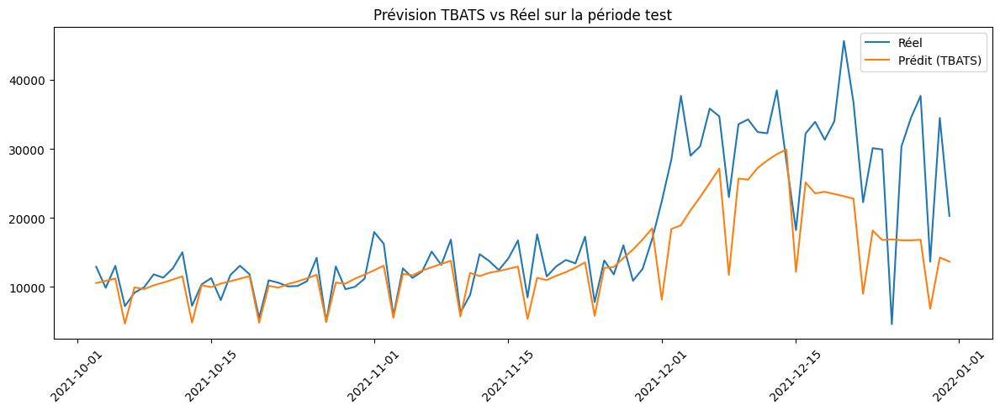

MAE  : 4,882.45
RMSE : 7,278.03
MAPE : 24.11%
R^2 : 0.4832047696486892


In [66]:
assert len(test) == len(tbats_forecast_orig)

# Création DataFrame pour la visualisation
tbats_df = test[['ds', 'y']].copy()
tbats_df['yhat_tbats'] = tbats_forecast_orig

plt.figure(figsize=(12,5))
plt.plot(tbats_df['ds'], tbats_df['y'], label='Réel')
plt.plot(tbats_df['ds'], tbats_df['yhat_tbats'], label='Prédit (TBATS)')
plt.legend()
plt.xticks(rotation=45)
plt.title("Prévision TBATS vs Réel sur la période test")
plt.tight_layout()
plt.show()
y_true = test['y'].values
y_pred = tbats_forecast_orig

mae  = mean_absolute_error(y_true, y_pred)
rmse = np.sqrt(mean_squared_error(y_true, y_pred))
mape = mean_absolute_percentage_error(y_true, y_pred) * 100  # en %

print(f"MAE  : {mae:,.2f}")
print(f"RMSE : {rmse:,.2f}")
print(f"MAPE : {mape:.2f}%")
print("R^2 :",r2_score(y_true, y_pred))


### Prophet

Entrainer Model Prophet:

In [ ]:
m = Prophet(
    yearly_seasonality=True,
    weekly_seasonality=True,
    daily_seasonality=False
)

m.fit(train)

future = test[['ds']].copy()
forecast = m.predict(future)

# Fusion pour comparer y réel vs yhat
test_pred = test.merge(
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']],
    on='ds',
    how='left'
)

14:53:57 - cmdstanpy - INFO - Chain [1] start processing
14:53:57 - cmdstanpy - INFO - Chain [1] done processing


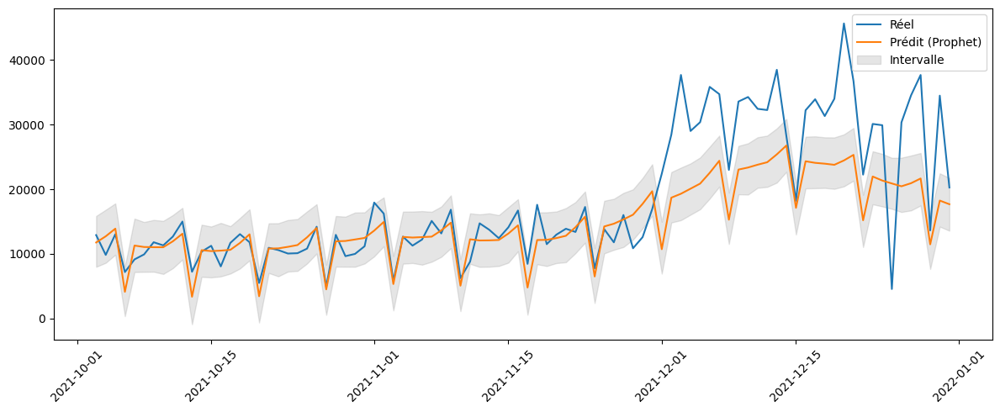

In [ ]:
plt.figure(figsize=(12,5))
plt.plot(test_pred['ds'], test_pred['y'], label='Réel')
plt.plot(test_pred['ds'], test_pred['yhat'], label='Prédit (Prophet)')
plt.fill_between(test_pred['ds'],
                 test_pred['yhat_lower'],
                 test_pred['yhat_upper'],
                 color='gray', alpha=0.2, label='Intervalle')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [69]:
test_pred = test.merge(
    forecast[['ds', 'yhat']],
    on='ds',
    how='left'
)

y_true = test_pred['y'].values
y_pred = test_pred['yhat'].values

mae  = mean_absolute_error(y_true, y_pred)
rmse = np.sqrt(mean_squared_error(y_true, y_pred))
mape = mean_absolute_percentage_error(y_true, y_pred) * 100  
r2=r2_score(y_true, y_pred)

print(f"MAE  : {mae:,.2f}")
print(f"RMSE : {rmse:,.2f}")
print(f"MAPE : {mape:.2f}%")
print(f"R^2  : {r2:.4f}")


MAE  : 4,538.99
RMSE : 6,706.82
MAPE : 24.00%
R^2  : 0.5611


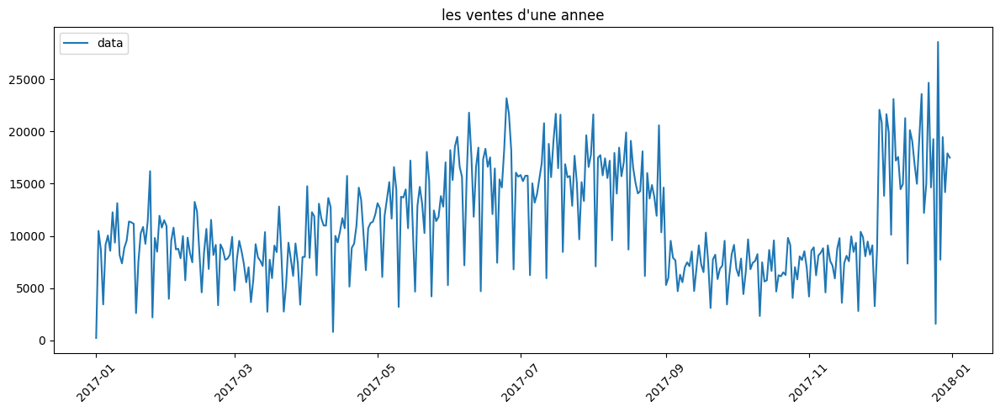

In [72]:
plt.figure(figsize=(12,5))
plt.plot(daily_all['ds'][:365], daily_all['y'][:365], label='data')
plt.legend()
plt.xticks(rotation=45)
plt.title("les ventes d'une annee")
plt.tight_layout()
plt.show()

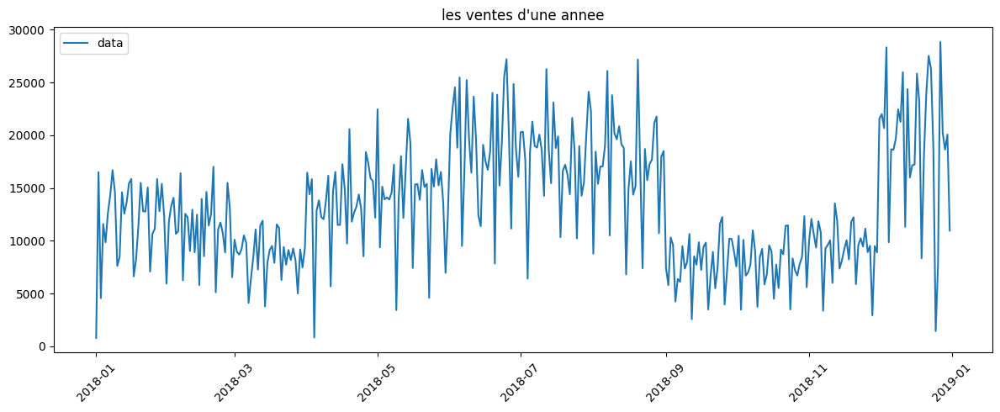

In [73]:
plt.figure(figsize=(12,5))
plt.plot(daily_all['ds'][365:730], daily_all['y'][365:730], label='data')
plt.legend()
plt.xticks(rotation=45)
plt.title("les ventes d'une annee")
plt.tight_layout()
plt.show()

lors de la la visualisation des ventes on ramrque que il y apresque les meme haut et bas des ventes et ces haut sont en periodes des vacances ou les promotion comme le black Friday ou soldes d'hiver,entree_scolaire ...

### Prophet avec Holidays

In [80]:

holidays = pd.DataFrame({
    'holiday': [
        'soldes_hiver', 'soldes_hiver', 'soldes_hiver', 'soldes_hiver', 'soldes_hiver', 'soldes_hiver',
        'saint_valentin', 'saint_valentin', 'saint_valentin', 'saint_valentin', 'saint_valentin', 'saint_valentin',
        'fete_meres', 'fete_meres', 'fete_meres', 'fete_meres', 'fete_meres', 'fete_meres',
        'soldes_ete', 'soldes_ete', 'soldes_ete', 'soldes_ete', 'soldes_ete', 'soldes_ete',
        'rentree_scolaire', 'rentree_scolaire', 'rentree_scolaire', 'rentree_scolaire', 'rentree_scolaire', 'rentree_scolaire',
        'black_friday', 'black_friday', 'black_friday', 'black_friday', 'black_friday', 'black_friday',
        'noel', 'noel', 'noel', 'noel', 'noel', 'noel'
    ],
    'ds': pd.to_datetime([
        '2017-01-04', '2018-01-10', '2019-01-09', '2020-01-08', '2021-01-06', '2022-01-12',
        '2017-02-14', '2018-02-14', '2019-02-14', '2020-02-14', '2021-02-14', '2022-02-14',
        '2017-05-28', '2018-05-27', '2019-05-26', '2020-05-24', '2021-05-30', '2022-05-29',
        '2017-06-28', '2018-06-27', '2019-06-26', '2020-07-15', '2021-06-23', '2022-06-22',
        '2017-09-04', '2018-09-03', '2019-09-02', '2020-09-01', '2021-09-02', '2022-09-01',
        '2017-11-24', '2018-11-23', '2019-11-29', '2020-11-27', '2021-11-26', '2022-11-25',
        '2017-12-15', '2018-12-15', '2019-12-15', '2020-12-15', '2021-12-15', '2022-12-15'
    ]),
    'lower_window': [-5]*6 + [-3]*6 + [-7]*6 + [-3]*6 + [-10]*6 + [-7]*6 + [-10]*6,
    'upper_window': [42]*6 + [2]*6 + [5]*6 + [35]*6 + [25]*6 + [10]*6 + [16]*6
})


In [ ]:


def add_regressors(df):
    """Ajoute des régresseurs pour améliorer les prédictions"""
    df = df.copy()
    
    # 1. Indicateurs temporels
    df['day_of_week'] = df['ds'].dt.dayofweek  # 0=Lundi, 6=Dimanche
    df['day_of_month'] = df['ds'].dt.day
    df['week_of_year'] = df['ds'].dt.isocalendar().week
    df['month'] = df['ds'].dt.month
    df['quarter'] = df['ds'].dt.quarter
    df['is_weekend'] = (df['ds'].dt.dayofweek >= 5).astype(int)
    df['is_month_start'] = (df['ds'].dt.day <= 7).astype(int)
    df['is_month_end'] = (df['ds'].dt.day >= 24).astype(int)
    
    # 2. Moyennes mobiles (tendances récentes)
    # Attention : calculer SEULEMENT sur train pour éviter data leakage
    if 'y' in df.columns:
        df['ma_7'] = df['y'].rolling(window=7, min_periods=1).mean()
        df['ma_30'] = df['y'].rolling(window=30, min_periods=1).mean()
        df['lag_7'] = df['y'].shift(7)
        df['lag_30'] = df['y'].shift(30)
    
    df['is_summer'] = df['month'].isin([6, 7, 8]).astype(int)
    df['is_christmas_season'] = df['month'].isin([11, 12]).astype(int)
    df['is_back_to_school'] = ((df['month'] == 8) | ((df['month'] == 9) & (df['day_of_month'] <= 15))).astype(int)
    
    return df
train_enriched = add_regressors(train)
test_enriched = add_regressors(test)

# Pour test, on ne peut pas utiliser les valeurs futures de 'y'
# Donc on utilise les dernières valeurs connues de train
last_values = train_enriched[['ma_7', 'ma_30', 'lag_7', 'lag_30']].tail(1)
for col in ['ma_7', 'ma_30', 'lag_7', 'lag_30']:
    if col in test_enriched.columns:
        test_enriched[col].fillna(last_values[col].values[0], inplace=True)


m_advanced = Prophet(
    yearly_seasonality=True,
    weekly_seasonality=True,
    daily_seasonality=False,
    holidays=holidays,
    changepoint_prior_scale=0.5,
    seasonality_prior_scale=0.1,
    holidays_prior_scale=20.0,
    seasonality_mode='multiplicative',
    interval_width=0.95
)

# Ajouter les régresseurs
regressors = [
    'day_of_week', 'is_weekend', 'is_month_start', 'is_month_end',
    'is_summer', 'is_christmas_season', 'is_back_to_school',
    'quarter'
]

for reg in regressors:
    m_advanced.add_regressor(reg)

# Entraînement
m_advanced.fit(train_enriched)

# Prédiction
forecast_advanced = m_advanced.predict(test_enriched)

# Évaluation
test_pred_advanced = test.merge(
    forecast_advanced[['ds', 'yhat', 'yhat_lower', 'yhat_upper']], 
    on='ds', how='left'
)

from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score

y_true = test_pred_advanced['y'].values
y_pred = test_pred_advanced['yhat'].values

print("📊 PERFORMANCES AVEC RÉGRESSEURS :")
print(f"MAE  : {mean_absolute_error(y_true, y_pred):,.2f}")
print(f"RMSE : {np.sqrt(mean_squared_error(y_true, y_pred)):,.2f}")
print(f"MAPE : {mean_absolute_percentage_error(y_true, y_pred)*100:.2f}%")
print(f"R²   : {r2_score(y_true, y_pred):.4f}")

15:34:08 - cmdstanpy - INFO - Chain [1] start processing
15:34:09 - cmdstanpy - INFO - Chain [1] done processing


📊 PERFORMANCES AVEC RÉGRESSEURS :
MAE  : 3,559.01
RMSE : 5,113.21
MAPE : 18.74%
R²   : 0.7449


In [180]:
import joblib

joblib.dump(m_advanced, "prophet_model.pkl")

['prophet_model.pkl']

**Forecasting**

In [84]:
df = df_merged.copy()
df["ds"] = pd.to_datetime(df["Date Order was placed"])
df = df.rename(columns={"Total Retail Price for This Order": "y"})

# ventes quotidiennes par produit
df_prod = (
    df.groupby(["Product ID", "ds"], as_index=False)["y"]
      .sum()
)


In [85]:
top_products = (
    df_prod.groupby("Product ID")["y"].sum()
          .sort_values(ascending=False)
          .head(20)  # ex. top 20 produits historiques
          .index
)

forecasts = []

for pid in top_products:
    sub = df_prod[df_prod["Product ID"] == pid].copy()
    sub = add_regressors(sub)  # ta fonction, adaptée pour ce df

    m = Prophet(
    yearly_seasonality=True,
    weekly_seasonality=True,
    daily_seasonality=False,
    holidays=holidays,
    changepoint_prior_scale=0.5,
    seasonality_prior_scale=0.1,
    holidays_prior_scale=20.0,
    seasonality_mode='multiplicative',
    interval_width=0.95
    )
    for reg in regressors:
        m.add_regressor(reg)

    m.fit(sub)

    future = m.make_future_dataframe(periods=30, freq="D")  # ex. 30 jours
    future = add_regressors(future)
    fc = m.predict(future)
    fc["Product ID"] = pid
    forecasts.append(fc[["Product ID", "ds", "yhat"]])

forecast_all = pd.concat(forecasts, ignore_index=True)

# Somme des ventes prévues par produit sur la période future
summary = (
    forecast_all[forecast_all["ds"] > df["ds"].max()]
    .groupby("Product ID")["yhat"]
    .sum()
    .sort_values(ascending=False)
)

# Produits les plus vendus (forecast)
top_future_products = summary.head(10)


15:34:50 - cmdstanpy - INFO - Chain [1] start processing
15:34:50 - cmdstanpy - INFO - Chain [1] done processing
15:34:50 - cmdstanpy - INFO - Chain [1] start processing
15:34:51 - cmdstanpy - INFO - Chain [1] done processing
15:34:51 - cmdstanpy - INFO - Chain [1] start processing
15:34:51 - cmdstanpy - INFO - Chain [1] done processing
15:34:51 - cmdstanpy - INFO - Chain [1] start processing
15:34:51 - cmdstanpy - INFO - Chain [1] done processing
15:34:52 - cmdstanpy - INFO - Chain [1] start processing
15:34:52 - cmdstanpy - INFO - Chain [1] done processing
15:34:52 - cmdstanpy - INFO - Chain [1] start processing
15:34:53 - cmdstanpy - INFO - Chain [1] done processing
15:34:53 - cmdstanpy - INFO - Chain [1] start processing
15:34:53 - cmdstanpy - INFO - Chain [1] done processing
15:34:54 - cmdstanpy - INFO - Chain [1] start processing
15:34:54 - cmdstanpy - INFO - Chain [1] done processing
15:34:54 - cmdstanpy - INFO - Chain [1] start processing
15:34:54 - cmdstanpy - INFO - Chain [1]

15:37:59 - cmdstanpy - INFO - Chain [1] start processing
15:37:59 - cmdstanpy - INFO - Chain [1] done processing
15:37:59 - cmdstanpy - INFO - Chain [1] start processing
15:37:59 - cmdstanpy - INFO - Chain [1] done processing
15:37:59 - cmdstanpy - INFO - Chain [1] start processing
15:37:59 - cmdstanpy - INFO - Chain [1] done processing
15:37:59 - cmdstanpy - INFO - Chain [1] start processing
15:37:59 - cmdstanpy - INFO - Chain [1] done processing
15:37:59 - cmdstanpy - INFO - Chain [1] start processing
15:37:59 - cmdstanpy - INFO - Chain [1] done processing
15:37:59 - cmdstanpy - INFO - Chain [1] start processing
15:37:59 - cmdstanpy - INFO - Chain [1] done processing
15:38:00 - cmdstanpy - INFO - Chain [1] start processing
15:38:00 - cmdstanpy - INFO - Chain [1] done processing
15:38:00 - cmdstanpy - INFO - Chain [1] start processing
15:38:00 - cmdstanpy - INFO - Chain [1] done processing
15:38:00 - cmdstanpy - INFO - Chain [1] start processing
15:38:00 - cmdstanpy - INFO - Chain [1]

Top 10 produits (ventes prédites sur les 30 prochains jours) :
Product Name
Top-form 325 Treadmill                 137432.196083
Letour Trimag Bike                      57893.236426
Letour Heart Bike                       53013.132852
Big Guy Men's Mountain Jacket           41177.422800
Mayday Trippler 3/4 Long Ski Jacket     40559.615739
Tx Peak Parka                           28577.591851
Family Holiday 4                        28044.640651
Family Holiday 6                        28021.556735
Men's Goretex Outdoor Jacket            25967.667025
Jeff's Hockey                           22418.577361
Name: yhat, dtype: float64


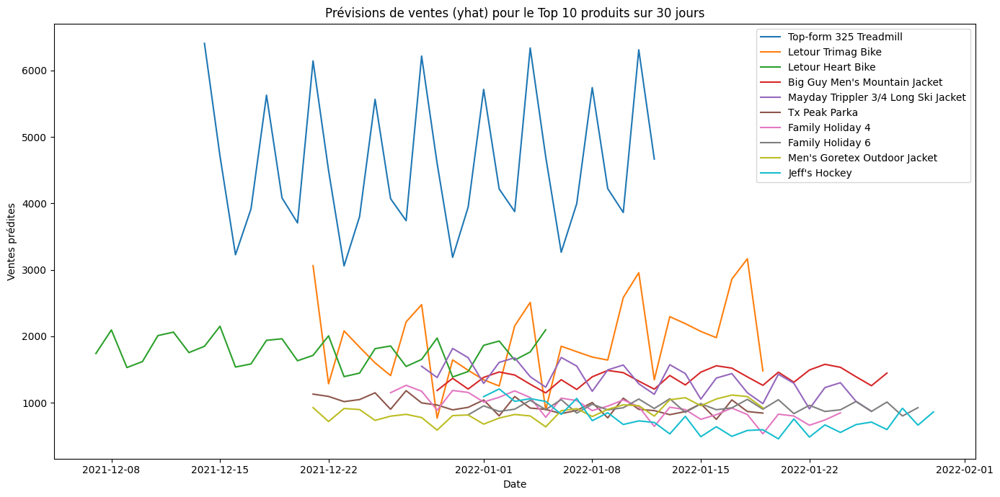

In [86]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from prophet import Prophet

# ========= 1) Charger et préparer =========
df = df_merged.copy()

df = df.rename(columns={
    "Date Order was placed": "ds",
    "Total Retail Price for This Order": "y"
})
df["ds"] = pd.to_datetime(df["ds"])

# Vérifier qu'on a bien une colonne produit
assert "Product Name" in df.columns, "Colonne 'Product Name' manquante dans df_merged"

# Agréger par produit + date (ventes quotidiennes par produit)
df_prod = (
    df.groupby(["Product Name", "ds"], as_index=False)["y"]
      .sum()
)

# ========= 2) Définir fonction pour ajouter quelques features simples =========
def add_basic_features(df):
    df = df.copy()
    df["day_of_week"] = df["ds"].dt.dayofweek
    df["month"] = df["ds"].dt.month
    df["is_weekend"] = (df["ds"].dt.dayofweek >= 5).astype(int)
    return df

# ========= 3) Boucler sur les produits et faire un forecast =========
# Pour éviter des modèles sur des produits avec 3 ventes, on filtre les produits
min_points = 30  # minimum de jours d'historique
product_counts = df_prod.groupby("Product Name")["ds"].count()
eligible_products = product_counts[product_counts >= min_points].index

# Optionnel : limiter au top N produits historiques pour aller plus vite
N_hist = 50
top_hist_products = (
    df_prod.groupby("Product Name")["y"]
           .sum()
           .sort_values(ascending=False)
           .head(N_hist)
           .index
)

product_list = [p for p in eligible_products if p in top_hist_products]

all_forecasts = []  # on stocke ici les prévisions de tous les produits

horizon = 30  # nb de jours à prévoir

for pid in product_list:
    sub = df_prod[df_prod["Product Name"] == pid].copy()
    sub = add_basic_features(sub)

    # Prophet demande ds, y (+ régressseurs éventuels)
    m = Prophet(
        yearly_seasonality=True,
        weekly_seasonality=True,
        daily_seasonality=False,
        interval_width=0.95
    )
    # Exemple : on ajoute seulement day_of_week, is_weekend comme régressseurs simples
    m.add_regressor("day_of_week")
    m.add_regressor("is_weekend")

    m.fit(sub[["ds", "y", "day_of_week", "is_weekend"]])

    future = m.make_future_dataframe(periods=horizon, freq="D")
    future = add_basic_features(future)

    forecast = m.predict(future)

    # On garde seulement l'horizon futur
    forecast_future = forecast[forecast["ds"] > sub["ds"].max()].copy()
    forecast_future["Product Name"] = pid

    all_forecasts.append(forecast_future[["Product Name", "ds", "yhat"]])

# Concat de toutes les prévisions
forecast_all = pd.concat(all_forecasts, ignore_index=True)

# ========= 4) Calculer les ventes prédites totales par produit sur l'horizon =========
future_sales_by_product = (
    forecast_all.groupby("Product Name")["yhat"]
                .sum()
                .sort_values(ascending=False)
)

top_10_future = future_sales_by_product.head(10)
print("Top 10 produits (ventes prédites sur les", horizon, "prochains jours) :")
print(top_10_future)

# ========= 5) Visualiser les courbes pour le Top 10 =========
top10_ids = top_10_future.index.tolist()

plt.figure(figsize=(14, 7))
for pid in top10_ids:
    sub_fc = forecast_all[forecast_all["Product Name"] == pid]
    plt.plot(sub_fc["ds"], sub_fc["yhat"], label=str(pid))

plt.title(f"Prévisions de ventes (yhat) pour le Top 10 produits sur {horizon} jours")
plt.xlabel("Date")
plt.ylabel("Ventes prédites")
plt.legend()
plt.tight_layout()
plt.show()
